In [1]:
import pylab             as     pl
import pandas            as     pd
import numpy             as     np
import matplotlib.pyplot as     plt
import matplotlib.cm     as     cm
import astropy.constants as     const
import astropy.units     as     u

from   astropy.table     import Table
from   tools.legacy      import cutout
from   IPython.display   import Image 
from   pkg_resources     import resource_filename

# More than meets the eye

There's very little more impressive in the Universe than a Cluster behemoth, with up to a 1000 galaxies locked down into the smallest of spaces.  

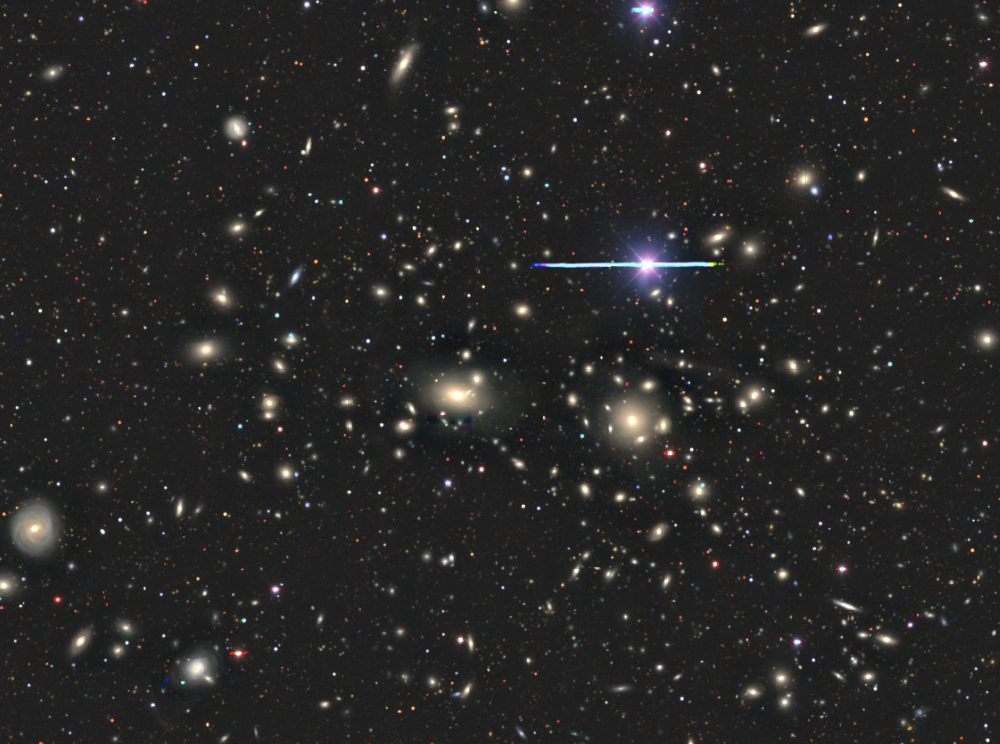

In [2]:
Image(filename='desihigh/images/legacy_tsz.png')

But how do we know these galaxies are in the same space, rather than chance projections onto the sky from galaxies at very different distances?  With spectra of course!  By measuring the redshift of each galaxy, we find they're nearest neighbours in both the radially direction and on the sky.  That makes them incredibly rare and worthy of some dedicated attention.  Maybe there's more than meets the eye? 

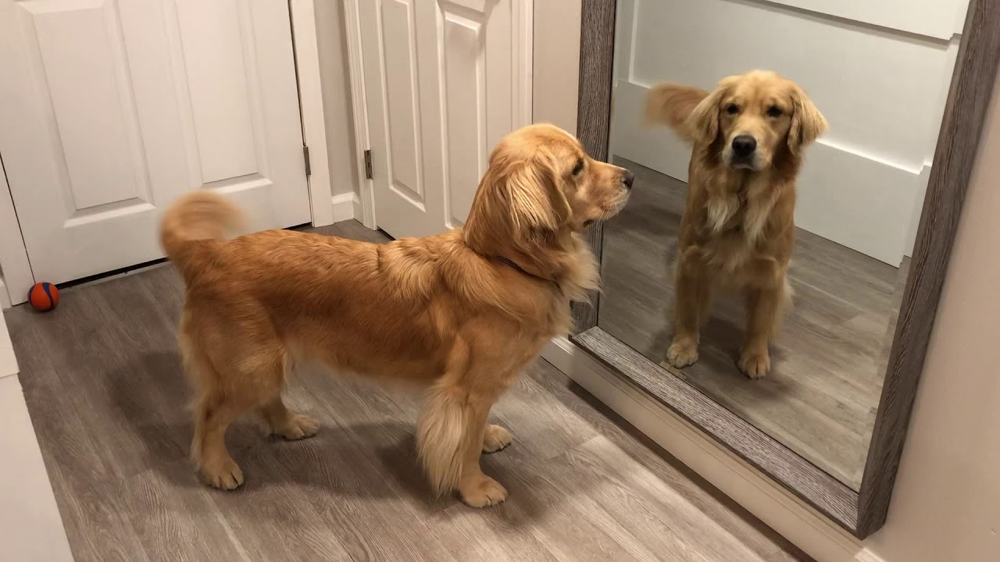

In [4]:
Image(filename='desihigh/images/optical_retriever.jpg', width=500)

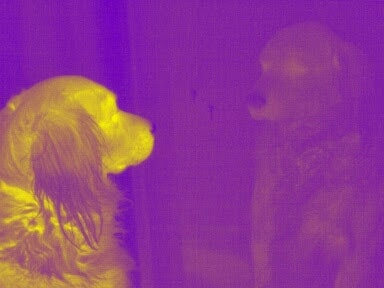

In [5]:
Image(filename='desihigh/images/ir_retriever.jpg', width=500)

What's different between these two images?  Take a minute to think on it!

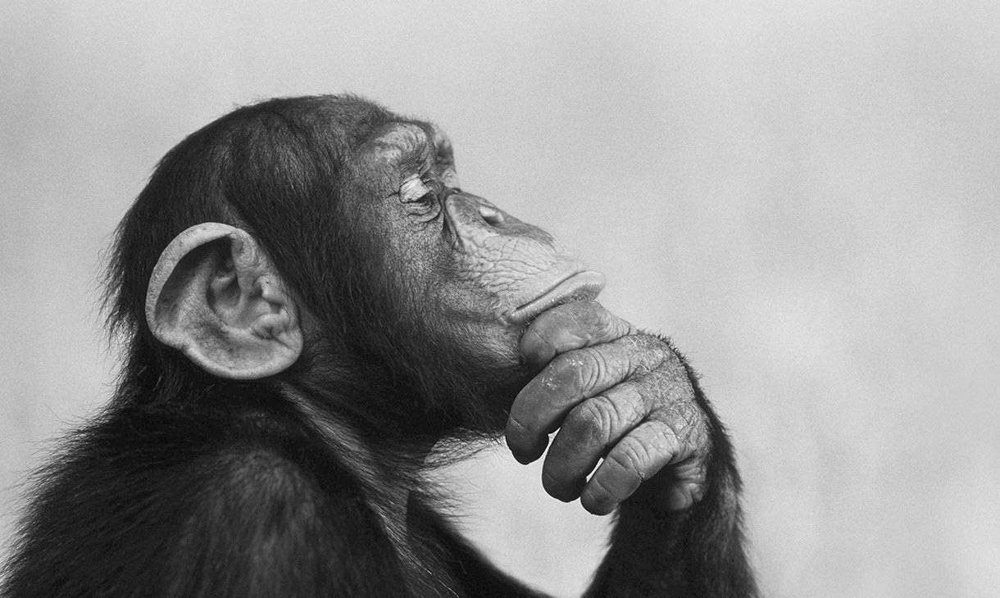

In [6]:
Image(filename='desihigh/images/thinking.jpeg', width=500)

Got an answer yet?  No, ok, give it another minute (hint there's a clue in the filename).

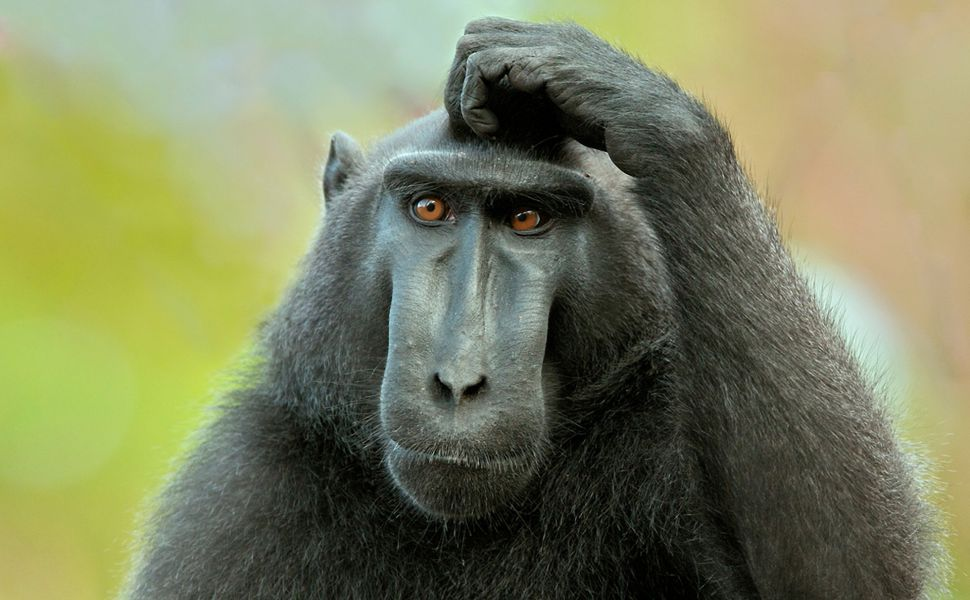

In [7]:
Image(filename='desihigh/images/still_thinking.jpg', width=500)

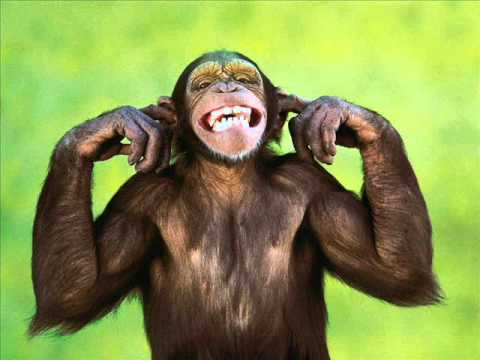

In [8]:
Image(filename='desihigh/images/happy.jpg', width=500)

Ah, we see you got it!  That's right, when we wear specially equipped Infrared googles, we see a measure of the warmth of our favourite dog, rather than how reflective its coat is - as we do with everyday-old `optical' vision.  

So what do we see outside the optical for a galaxy cluster?     

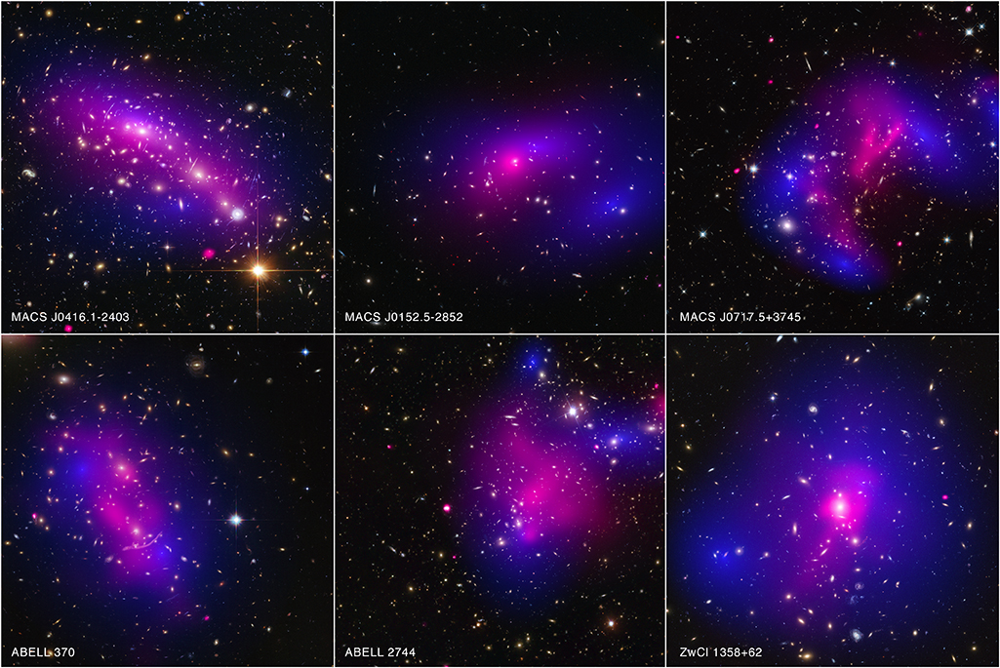

In [9]:
Image(filename='desihigh/images/ChandraClusters.jpg', width=1000)

Wow! Well that was worth it for the picture alone.  What did we learn?  By looking at wavelength much _shorter_ than optical we see the events happening at very high energy.  Here, in the X-ray, we see the very hot `Intracluster medium' that bulks out the space between galaxies.  This gas is simply good old hydrogen and helium, as you would pop over a bunsen, but it's just too hot to collapse further and form stars.  

It's a big deal to take a shot like this.  Fortunately for us, the atmosphere is opaque to X-rays so it was only in the 1950s that we could go to space and see this whole new world.  Remember, up until SpaceX came along, satellites were a really big deal as rocket launches cost a lot of money.  Rockets also have to be small to minimise the weight and air resistiance, so telescopes in space have to be small;  More about [SpaceX](https://www.spacex.com/) in another notebook.  

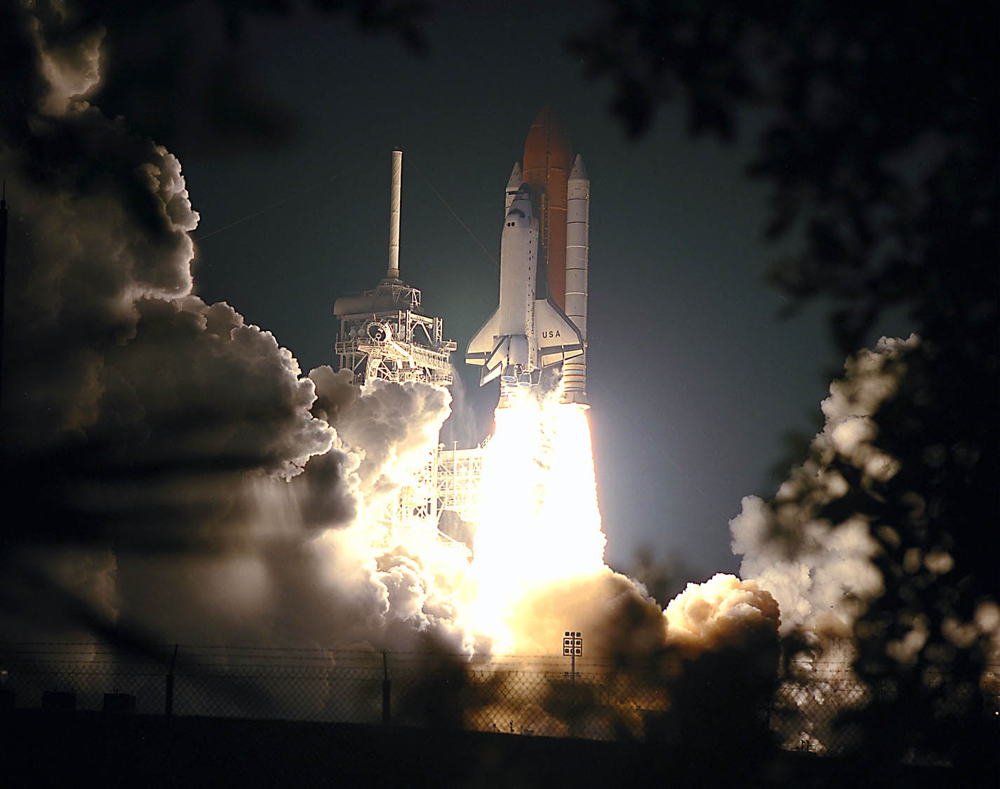

In [10]:
Image(filename='desihigh/images/Launch.jpg', width=1000)

But the designers of [Chandra](https://www.nasa.gov/mission_pages/chandra/main/index.html) decided it was totally worth it to explore this whole new frontier of X-ray astronomy!

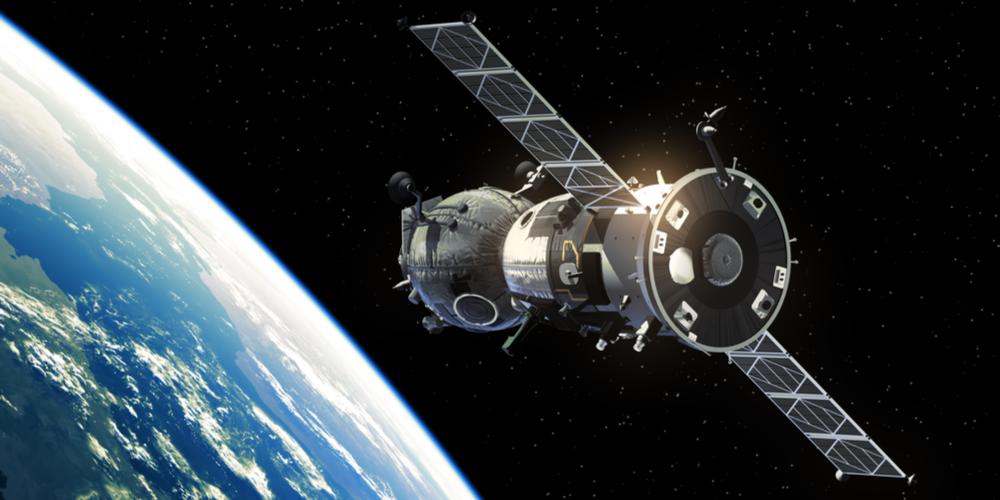

In [11]:
Image(filename='desihigh/images/Chandra.png', width=1000)

So, is there an Infrared picture of a cluster?  Of course, it would tell us about the gas that's a bit less hot.  But can we be clever and find other new ways that don't rely on the gas being hot enough to emit?  We're Astronomers, that's our job!

What if we look for the effect of the Cluster on the light emitted by other sources, that'd do the job, right?  As usual, Einstein give us the first means by predicting that light would be pushed around by other matter as it travelled through the Universe.  So much for Newton and his straight lines!  

For a very distance background, we'd see multiple images as the light gets bent around the lens:

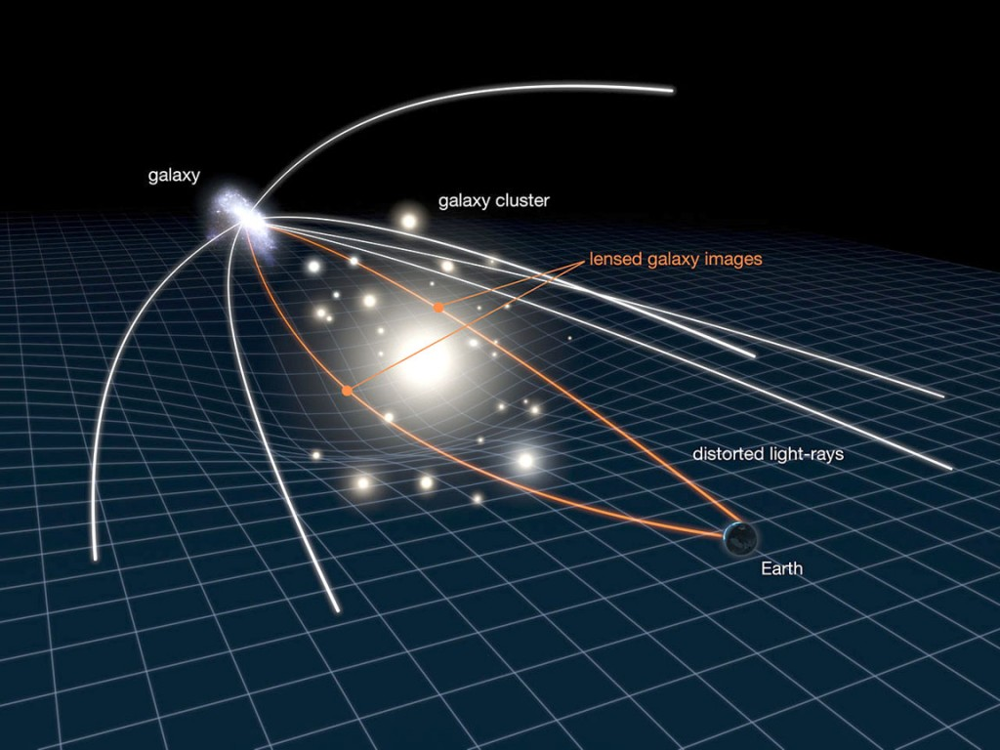

In [12]:
Image(filename='desihigh/images/StrongLensDiagram.jpg', width=1000)

For a perfect alignment of source and lens, we can even see a whole Einstein ring composed of overlapping images:  

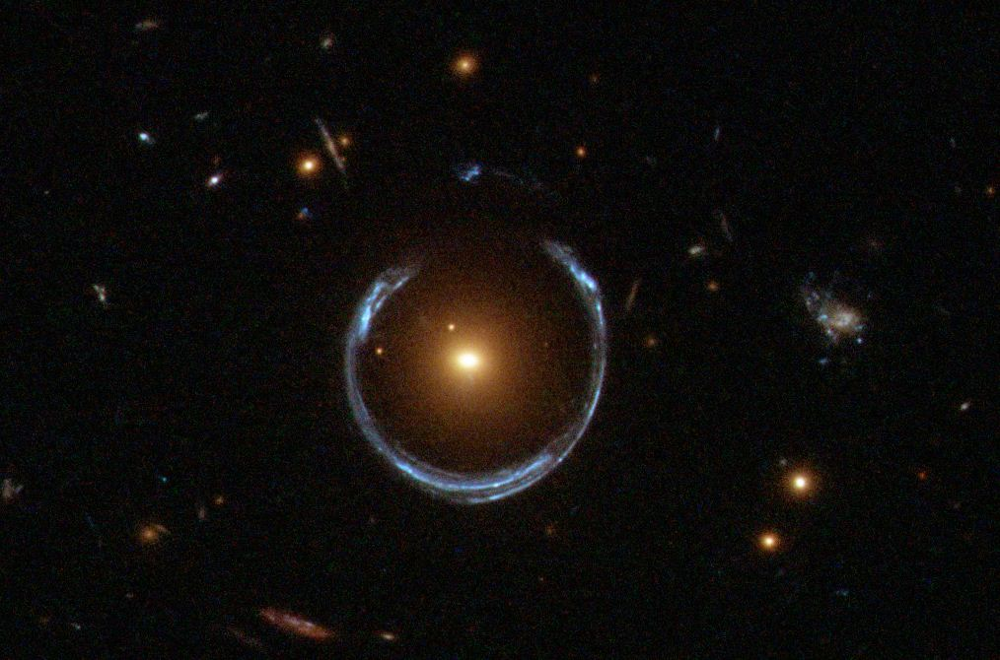

In [13]:
Image(filename='desihigh/images/StrongLens.jpeg', width=1000)

This is incredibly useful, as the radius of the ring, according to Einstein, tells us the exact mass enclosed within it. 

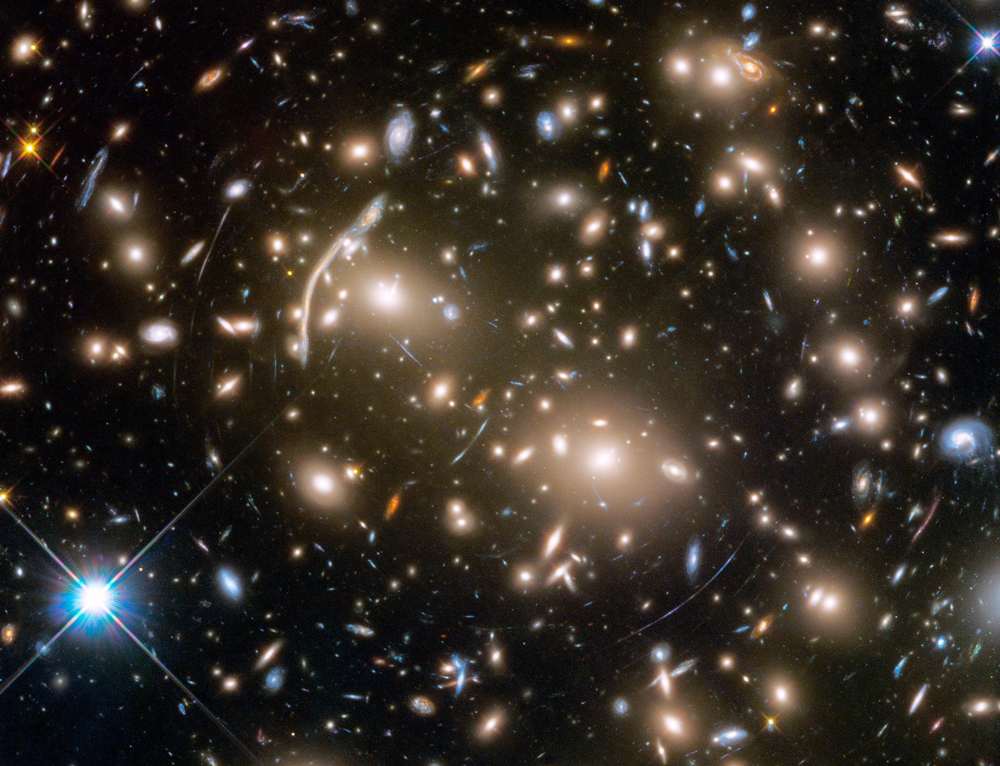

In [14]:
Image(filename='desihigh/images/ClusterStrongLensing.jpg', width=1000)

For a cluster, rather than a single source, things get hairy as we see the partial rings that survive as they're buffeted by all the other matter.

# The Cosmic Shadow Theater

Let's think even more outside the box.  Rather than light from distance galaxies, what about lensing of light from the 'Big Bang' itself?  

Our first notebook introduced the expansion of the Universe and the recent detection of a Cosmic acceleration.  What happens when we run back the clock?

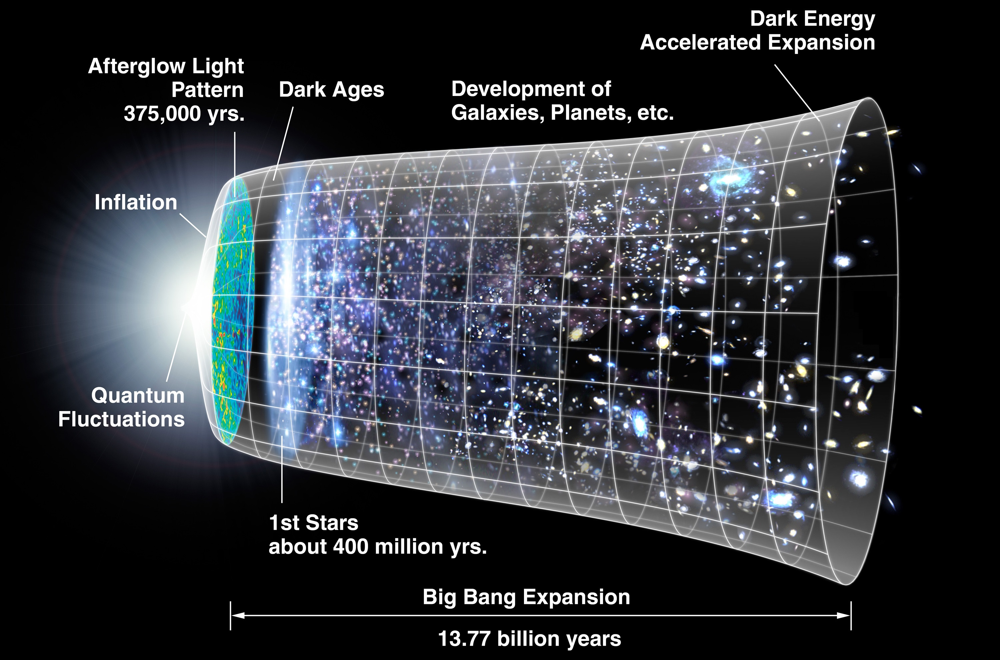

In [15]:
Image(filename='desihigh/images/CMB_Cone.jpg', width=1000)

If galaxies are separating from either other today, then their distribution must have been even more dense in the past.  The one mistake to avoid here is to think that there is one point to which everything collapses.  Rather, all of space gets denser at the same rate, as matter from outside comes crashing in.   

Things got so hot, and so dense, in the past that light was being emitted everywhere, but it was trapped as Hydrogen continually absorbed and remitted any given photon.  Once the Universe got sufficient cool, the photons were free!  Since then they've been travelling 13.8 billion years to see us, and its quite the picture:   

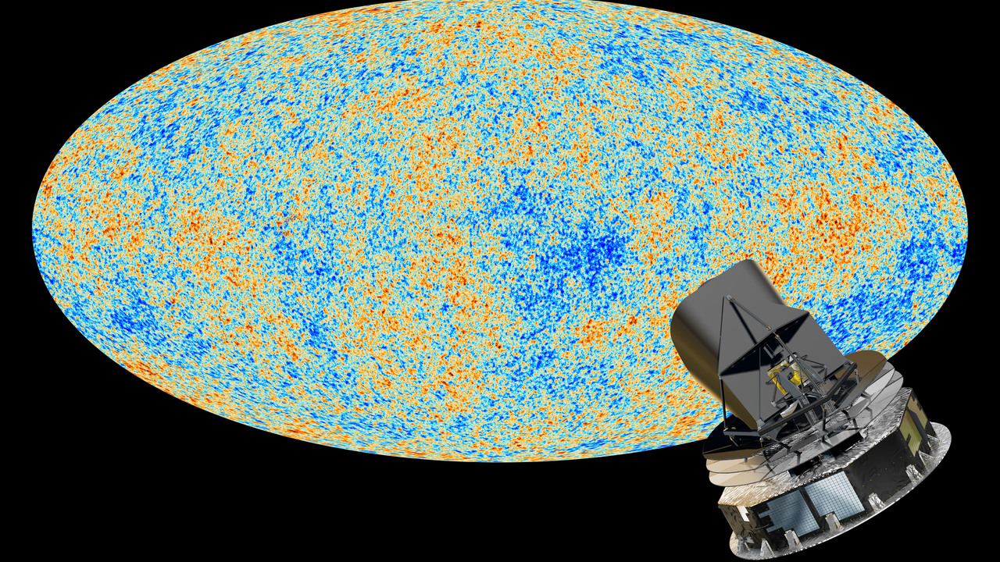

In [16]:
Image(filename='desihigh/images/PlanckCMB.jpg', width=1000)

Here the fluctuations in color represent differences in temperature, which are caused by differences in density across the volume from which the photon first began their journey.  The keen eyed amongst you will spot that it took yet another space telescope, the [Planck](https://www.esa.int/Science_Exploration/Space_Science/Planck/Planck_and_the_cosmic_microwave_background) mission, to get us this far.  As the Universe expands, the color of light gets redder at the same rate.  The Universe is very old so the CMB has a very long wavelength.   

If this CMB light lensed by matter as it travels towards us?  Of course, that could be the topic for another notebook!  But more interesting here is the new effect that the electrons in the cluster also scatter the CMB light of one color (wavelength) to another.

# The Astronomer's Golden Rule

$\Large \theta = 1.22 \left ( \frac{\lambda}{D} \right ) $

If you have a telescope with a mirror of diameter $D$ [cm], observing light of wavelength $\lambda$ [cm], the angular size of sources you can identify clearly (resolve) is $\theta$ [radians] _at best_.  Let's see this in action.

In [22]:
space                          = {'CHANDRA': {'BAND': 'XRAY', 'WAVELENGTH': 1.2, 'DIAMETER': 1.2}} # [Angstroms, Meters].

space['PLANCK']                = {'BAND': 'MICROWAVE', 'FREQUENCY': 44, 'DIAMETER': 1.6}           # [GigaHertz, Meters].
space['PLANCK']['WAVELENGTH']  = 2.9979e8 / space['PLANCK']['FREQUENCY'] / 1.e9                    # [Meters].
space['PLANCK']['WAVELENGTH'] *= 1.e10                                                             # [Angstroms].

In [23]:
ground     = {'DESI': {'BAND': 'GRZ', 'WAVELENGTH': 4000., 'DIAMETER': 3.8}}

In [24]:
# Revisit.
for altitude in [space, ground]:
  for key in altitude.keys():
    diam   = 100. * altitude[key]['DIAMETER']         # [cm]
    wave   = 1.e-8 * altitude[key]['WAVELENGTH']      # [cm]
         
    theta  = 1.22 * wave / diam                       # [radians]  
    theta *= 180. / np.pi                             # [degrees]
    theta *= 60.                                      # [arcmin] 
    
    altitude[key]['BEAMSIZE'] = theta
    
    print('{: <16}\t{:.1f}\t{:.1e}'.format(key, diam, theta))

CHANDRA         	120.0	4.2e-07
PLANCK          	160.0	1.8e+01
DESI            	380.0	4.4e-04


Now, DESI never actually achieves this 'Diffraction limit' resolution, as the atmosphere blurring dominates.  While Planck have a relatively poor resolution, even for the smallest source in the Universe Planck would see it as $\simeq (1/6)$ the size of the full moon. 

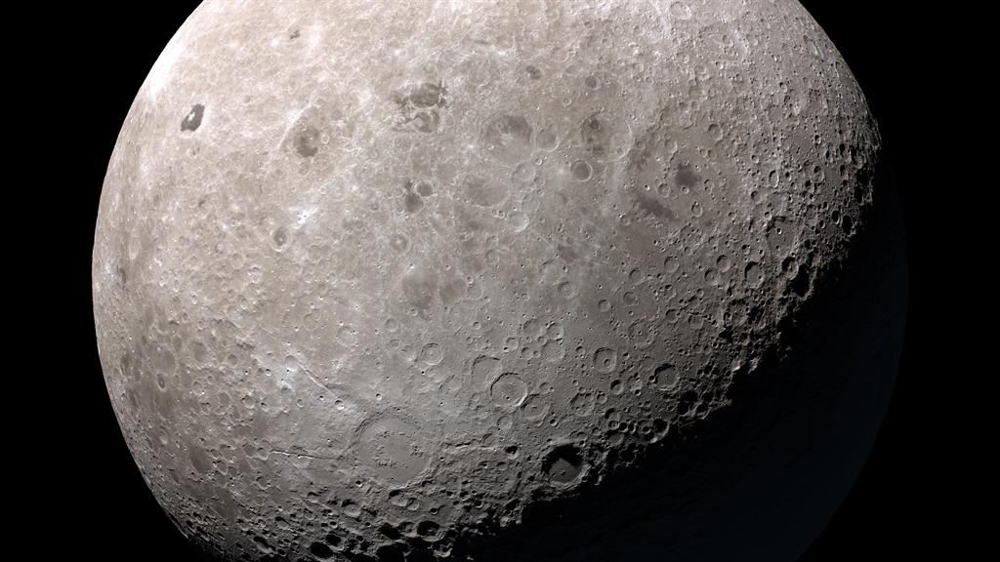

In [17]:
Image(filename='desihigh/images/MoonPlanck.jpg', width=1000)

That, when you looking for clusters of galaxies in the Universe, sucks!  So the [Atacama Cosmology Telescope](https://act.princeton.edu/) team packed up their things on the nearest lama (not literally!) and set out to build a _ground based_ telescope.  Why?  Because you can't fit a 6m telescope on a rocket!  

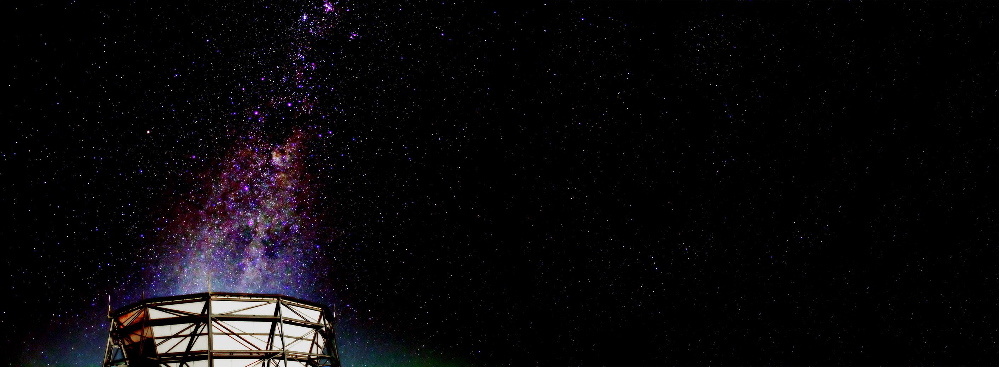

In [18]:
Image(filename='desihigh/images/ACT.jpg', width=1000)

It's fair to say ACT looks more like a bucket than a conventional telescope!  But they do a hell of a job at finding clusters.

In [19]:
Image(filename='desihigh/images/act_louis+16.jpg', width=600)

Pretty psychedelic, isn't it?  The bacteria-like streaks in red and blue is the primary CMB, as for Planck.  The sharp dots circled are resolved clusters identifed by ACT.  How?  Because the CMB light that passed through the cluster had its frequency changed as it interacted with the electrons there.  The result is a shadow from the cooler gas around the cluster galaxies!  We have only known about this [thermal Sunyaev-Zel'dovich effect](https://en.wikipedia.org/wiki/Sunyaev%E2%80%93Zeldovich_effect) for _50_ years or so. 

This scattering is similar to why the sky is sometimes bluer further from the Sun, and more pink towards it -- particularly during sunsets.  This is because the air deflects or "scatters" the blue light from the Sun. As a result, the sky looks blue away from the Sun. Towards the Sun, because the air deflects the blue light, only the pink light from the Sun makes it to your eyes.

Let's use ACT's high resolution to really zoom in on the cluster:

In [21]:
decs = np.loadtxt(resource_filename('desihigh', 'dat/comptony/decmap_ra0.96_dec2.08.txt'))
ras  = np.loadtxt(resource_filename('desihigh', 'dat/comptony/ramap_ra0.96_dec2.08.txt'))
ys   = np.loadtxt(resource_filename('desihigh', 'dat/comptony/stampmap_ra0.96_dec2.08.txt'))

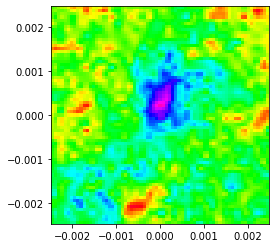

In [22]:
plt.imshow(ys, extent=(ras.min(), ras.max(), decs.min(), decs.max()),
           interpolation='nearest', cmap=cm.gist_rainbow)

The real beauty is that Planck and ACT measure the cluster at _different_ wavelengths, just not as different as Chandra or DESI would.  Given our understanding of the scattering between electrons and clusters we can predict how this would look in the different wavelength 'channels'.

We'll need some common units in Astronomy:

In [23]:
# Boltzmann constant, https://en.wikipedia.org/wiki/Boltzmann_constant. 
kB = const.k_B.value

# Planck constant, https://en.wikipedia.org/wiki/Planck_constant.
hh = const.h.value

This little cell gave us some of the most important realizations in Physics, ever!  We also need the observed mean temperature of the CMB.   

In [24]:
TT = 2.755

In [34]:
def theta(y, nu):
    # Eqn. 1 of https://arxiv.org/pdf/astro-ph/0402115.pdf. 
    x = hh * nu / kB / TT 
    
    return - 2 * y * (2. - 0.5 * x / np.tanh(x / 2.))

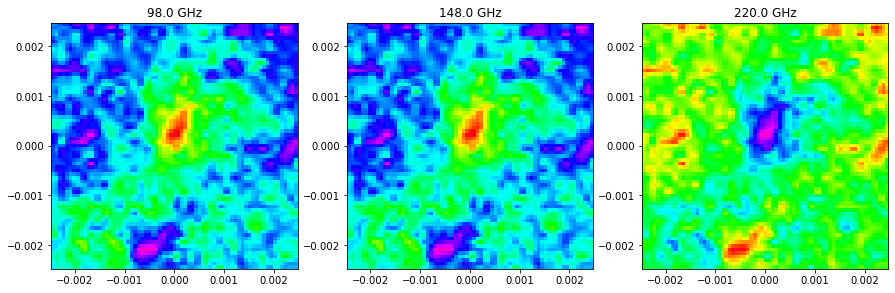

In [35]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

for i, nu in enumerate([98., 148., 220.]):
    cluster_map = theta(ys, 1.e9 * nu) 
    
    axes[i].imshow(cluster_map, extent=(ras.min(), ras.max(), decs.min(), decs.max()),
           interpolation='nearest', cmap=cm.gist_rainbow)
    
    axes[i].set_title('{:.1f} GHz'.format(nu))

The fact that the observed temperature of photons in a given direction goes from negative to positive tells us this is a bonafide cluster.

It's a good thing we were able to find these 'warm' baryons buried in clusters with the CMB and ACT, up until that point we only knew where [50% of the atoms where!](https://en.wikipedia.org/wiki/Missing_baryon_problem).   

# Debrief

That was a lot!  Take a break and have a congratulatory coffee for your hard work so far.  When you come back, we'll summarise why it takes two ground based telescope and two satellites to better understand Dark Energy with clusters.

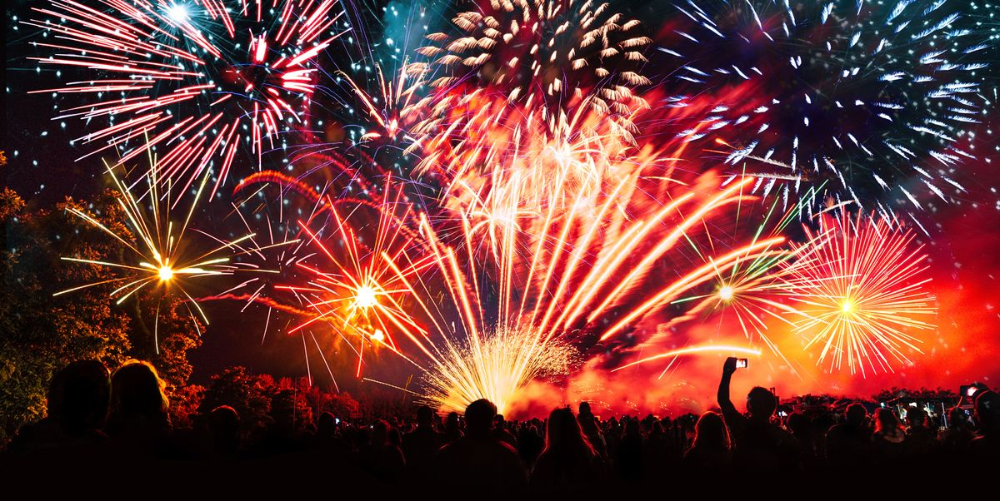

In [25]:
Image(filename='desihigh/images/Fireworks.jpg', width=1000)

All partied out?  Good, let's get back to work!  If you haven't checked out nbody.ipynb do so now, then call back in. 

Let's pick up with a cluster DESI will soon observe.  DESI had a baby brother, the [BOSS](http://www.sdss3.org/surveys/boss.php) survey, that picked up this one already.  Once DESI really gets going it will observe the same number of galaxies as the BOSS survey _in a month_.

'https://www.legacysurvey.org/viewer/cutout.jpg?ra=0.9600&dec=2.0800&layer=dr8&pixscale=1.00'

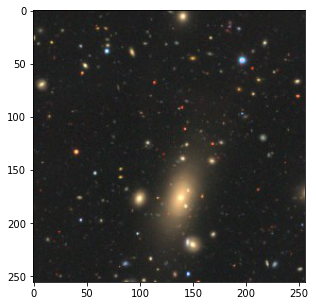

In [37]:
fig, ax = plt.subplots(1,1, figsize=(10,5))

cutout(ax, 0.96, 2.08)

By getting redshifts for the galaxy in the cluster, we can determine what galaxies are just chance projections in the sky. 

In [26]:
clusters = Table.read(resource_filename('desihigh', 'dat/tsz_boss_cluster_zs.fits'))
clusters.sort('RA')
clusters

Z,RA,Dec
float32,float64,float64
0.55196553,0.4655085100000065,1.9834607
0.3256376,0.47270830999997315,1.6665703
0.40968463,0.4782056000000239,2.0804978
0.46985555,0.4826265500000204,1.8415965
0.5186644,0.4965496799999869,1.6571474
0.45965716,0.4966486100000225,2.5257169
0.3220028,0.4972627500000044,1.6752201
0.6675677,0.5032387100000051,1.9347973
0.64829934,0.5032846099999801,1.8551565


If we know the size of a typical cluster, then any galaxies that aren't sufficiently close to the mean redshift shouldn't be counted as a member.

In [39]:
# Center redshift of the cluster.
meanz = np.mean(clusters['Z'])

# Typical difference for a given galaxy in the cluster from meanz.
stdz  =  np.std(clusters['Z'])

In [40]:
in_cluster = ((clusters['Z'] - meanz) / stdz) < 1.0

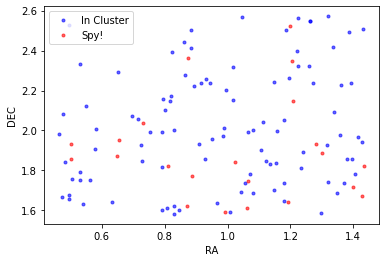

In [41]:
pl.plot(clusters['RA'][in_cluster],  clusters['Dec'][in_cluster],  marker='.', lw=0.0, c='b', alpha=0.6, label='In Cluster')
pl.plot(clusters['RA'][~in_cluster], clusters['Dec'][~in_cluster], marker='.', lw=0.0, c='r', alpha=0.6, label='Spy!')

pl.xlabel('RA')
pl.ylabel('DEC')

pl.legend(loc=2)

If we know how many galaxies are in the cluster, or its richness, we can get a rough estimate of the mass assuming we know how much dark matter is associated with every cluster galaxy.  It's a tricky business, and not one for the faint of heart! A _much_ better method is to use measurements of the Einstein ring to determine the mass via lensing. 

Why do we care?  Because n-body simulations tell us that the number of clusters in a given mass range is _really_ sensitive to the type of Dark Energy in the Universe.  This is great, because if we get it right then we learn a lot about Dark Energy!  But if we make any small mistake, then the implications for the conclusions we draw about Dark Energy will be really wrong, not just a little wrong. 

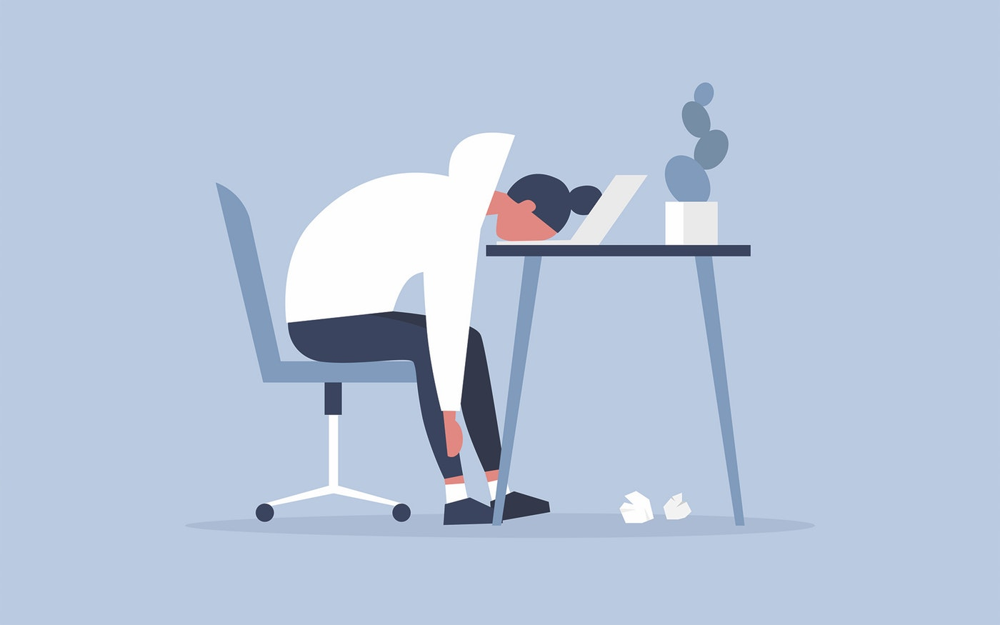

In [27]:
Image(filename='desihigh/images/Mistake.jpg', width=600)

That's why the Baryon Acoustic Oscillations introduced in RipplesInTheCosmos.ipynb are so valuable!  They're very good at telling us about Dark Energy _without_ an easy opportunity to go wrong.    

And what about the CMB data?  Well, if we have a really good sample of lensing-derived masses then we can 'calibrate' the relation between the mass and the frequency difference observed in the CMB.  This gives us _estimated_ masses for a _much_ larger sample of clusters in the Universe, with a few strings attached.